# Big Data Mart Sales Problem

In [167]:
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns
import warnings 
warnings.filterwarnings('ignore')

In [168]:
train_data=pd.read_csv('bb1.csv')

In [169]:
train_data

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,FDA15,9.300,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735.1380
1,DRC01,5.920,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.4228
2,FDN15,17.500,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097.2700
3,FDX07,19.200,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,NaN,Tier 3,Grocery Store,732.3800
4,NCD19,8.930,Low Fat,0.000000,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,994.7052
5,FDP36,10.395,Regular,0.000000,Baking Goods,51.4008,OUT018,2009,Medium,Tier 3,Supermarket Type2,556.6088
6,FDO10,13.650,Regular,0.012741,Snack Foods,57.6588,OUT013,1987,High,Tier 3,Supermarket Type1,343.5528
7,FDP10,NaN,Low Fat,0.127470,Snack Foods,107.7622,OUT027,1985,Medium,Tier 3,Supermarket Type3,4022.7636
8,FDH17,16.200,Regular,0.016687,Frozen Foods,96.9726,OUT045,2002,NaN,Tier 2,Supermarket Type1,1076.5986
9,FDU28,19.200,Regular,0.094450,Frozen Foods,187.8214,OUT017,2007,NaN,Tier 2,Supermarket Type1,4710.5350


In [170]:
test_data=pd.read_csv('bb.csv')

In [171]:
test_data

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type
0,FDW58,20.750,Low Fat,0.007565,Snack Foods,107.8622,OUT049,1999,Medium,Tier 1,Supermarket Type1
1,FDW14,8.300,reg,0.038428,Dairy,87.3198,OUT017,2007,NaN,Tier 2,Supermarket Type1
2,NCN55,14.600,Low Fat,0.099575,Others,241.7538,OUT010,1998,NaN,Tier 3,Grocery Store
3,FDQ58,7.315,Low Fat,0.015388,Snack Foods,155.0340,OUT017,2007,NaN,Tier 2,Supermarket Type1
4,FDY38,NaN,Regular,0.118599,Dairy,234.2300,OUT027,1985,Medium,Tier 3,Supermarket Type3
5,FDH56,9.800,Regular,0.063817,Fruits and Vegetables,117.1492,OUT046,1997,Small,Tier 1,Supermarket Type1
6,FDL48,19.350,Regular,0.082602,Baking Goods,50.1034,OUT018,2009,Medium,Tier 3,Supermarket Type2
7,FDC48,NaN,Low Fat,0.015782,Baking Goods,81.0592,OUT027,1985,Medium,Tier 3,Supermarket Type3
8,FDN33,6.305,Regular,0.123365,Snack Foods,95.7436,OUT045,2002,NaN,Tier 2,Supermarket Type1
9,FDA36,5.985,Low Fat,0.005698,Baking Goods,186.8924,OUT017,2007,NaN,Tier 2,Supermarket Type1


# Graphical Representation

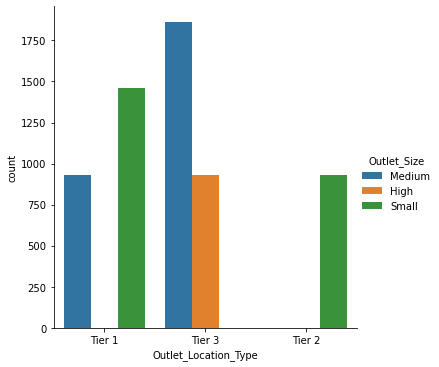

In [172]:
# Factorplot for Outlet Location Type vs Outlet Type for train data.
sns.factorplot('Outlet_Location_Type',hue='Outlet_Size',kind='count',data=df)

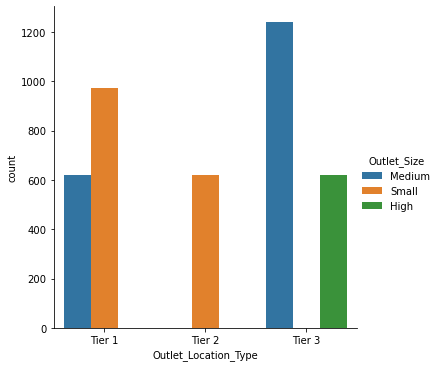

In [173]:
# Factorplot for Outlet Location Type vs Outlet Type for test data.
sns.factorplot('Outlet_Location_Type',hue='Outlet_Size',kind='count',data=test_data)

In [174]:
train_data.dtypes

Item_Identifier               object
Item_Weight                  float64
Item_Fat_Content              object
Item_Visibility              float64
Item_Type                     object
Item_MRP                     float64
Outlet_Identifier             object
Outlet_Establishment_Year      int64
Outlet_Size                   object
Outlet_Location_Type          object
Outlet_Type                   object
Item_Outlet_Sales            float64
dtype: object

In [175]:
test_data.dtypes

Item_Identifier               object
Item_Weight                  float64
Item_Fat_Content              object
Item_Visibility              float64
Item_Type                     object
Item_MRP                     float64
Outlet_Identifier             object
Outlet_Establishment_Year      int64
Outlet_Size                   object
Outlet_Location_Type          object
Outlet_Type                   object
dtype: object

In [176]:
train_data['Item_Identifier'].unique()

array(['FDA15', 'DRC01', 'FDN15', ..., 'NCF55', 'NCW30', 'NCW05'],
      dtype=object)

In [177]:
test_data['Item_Identifier'].unique()

array(['FDW58', 'FDW14', 'NCN55', ..., 'NCI29', 'FDP28', 'FDF04'],
      dtype=object)

In [178]:
train_data['Item_Fat_Content'].unique()

array(['Low Fat', 'Regular', 'low fat', 'LF', 'reg'], dtype=object)

In [179]:
test_data['Item_Fat_Content'].unique()

array(['Low Fat', 'reg', 'Regular', 'LF', 'low fat'], dtype=object)

the data is mispelled in the test data.since we are replace it into unique.

In [180]:
# Item Fat content is mispelled
test_data['Item_Fat_Content'].replace(['low fat','LF','reg'],['Low Fat','Low Fat','Regular'],inplace=True)

In [181]:
test_data['Item_Fat_Content'].unique()

array(['Low Fat', 'Regular'], dtype=object)

Now test data is also unique on Item Fat Content after replacing it.

In [182]:
train_data['Item_Type'].unique()

array(['Dairy', 'Soft Drinks', 'Meat', 'Fruits and Vegetables',
       'Household', 'Baking Goods', 'Snack Foods', 'Frozen Foods',
       'Breakfast', 'Health and Hygiene', 'Hard Drinks', 'Canned',
       'Breads', 'Starchy Foods', 'Others', 'Seafood'], dtype=object)

In [183]:
test_data['Item_Type'].unique()

array(['Snack Foods', 'Dairy', 'Others', 'Fruits and Vegetables',
       'Baking Goods', 'Health and Hygiene', 'Breads', 'Hard Drinks',
       'Seafood', 'Soft Drinks', 'Household', 'Frozen Foods', 'Meat',
       'Canned', 'Starchy Foods', 'Breakfast'], dtype=object)

Both test data and train data is unique on Item Type.

In [184]:
train_data['Outlet_Identifier'].unique()

array(['OUT049', 'OUT018', 'OUT010', 'OUT013', 'OUT027', 'OUT045',
       'OUT017', 'OUT046', 'OUT035', 'OUT019'], dtype=object)

In [185]:
train_data['Outlet_Identifier'].unique()

array(['OUT049', 'OUT018', 'OUT010', 'OUT013', 'OUT027', 'OUT045',
       'OUT017', 'OUT046', 'OUT035', 'OUT019'], dtype=object)

Both test data and train data is unique on Outlet Identifier.

In [186]:
train_data['Outlet_Size'].unique()

array(['Medium', nan, 'High', 'Small'], dtype=object)

In [187]:
test_data['Outlet_Size'].unique()

array(['Medium', nan, 'Small', 'High'], dtype=object)

Both test data and train data is unique on Outlet Size.

In [188]:
train_data['Outlet_Location_Type'].unique()

array(['Tier 1', 'Tier 3', 'Tier 2'], dtype=object)

In [189]:
test_data['Outlet_Location_Type'].unique()

array(['Tier 1', 'Tier 2', 'Tier 3'], dtype=object)

Both test data and train data is unique on Outlet Location type.

In [190]:
train_data['Outlet_Type'].unique()

array(['Supermarket Type1', 'Supermarket Type2', 'Grocery Store',
       'Supermarket Type3'], dtype=object)

In [191]:
test_data['Outlet_Type'].unique()

array(['Supermarket Type1', 'Grocery Store', 'Supermarket Type3',
       'Supermarket Type2'], dtype=object)

Both test data and train data is unique on Outlet type.

In [192]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8523 entries, 0 to 8522
Data columns (total 12 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Item_Identifier            8523 non-null   object 
 1   Item_Weight                7060 non-null   float64
 2   Item_Fat_Content           8523 non-null   object 
 3   Item_Visibility            8523 non-null   float64
 4   Item_Type                  8523 non-null   object 
 5   Item_MRP                   8523 non-null   float64
 6   Outlet_Identifier          8523 non-null   object 
 7   Outlet_Establishment_Year  8523 non-null   int64  
 8   Outlet_Size                6113 non-null   object 
 9   Outlet_Location_Type       8523 non-null   object 
 10  Outlet_Type                8523 non-null   object 
 11  Item_Outlet_Sales          8523 non-null   float64
dtypes: float64(4), int64(1), object(7)
memory usage: 799.2+ KB


In [193]:
test_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5681 entries, 0 to 5680
Data columns (total 11 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Item_Identifier            5681 non-null   object 
 1   Item_Weight                4705 non-null   float64
 2   Item_Fat_Content           5681 non-null   object 
 3   Item_Visibility            5681 non-null   float64
 4   Item_Type                  5681 non-null   object 
 5   Item_MRP                   5681 non-null   float64
 6   Outlet_Identifier          5681 non-null   object 
 7   Outlet_Establishment_Year  5681 non-null   int64  
 8   Outlet_Size                4075 non-null   object 
 9   Outlet_Location_Type       5681 non-null   object 
 10  Outlet_Type                5681 non-null   object 
dtypes: float64(3), int64(1), object(7)
memory usage: 488.3+ KB


In [194]:
train_data.isnull().sum()

Item_Identifier                 0
Item_Weight                  1463
Item_Fat_Content                0
Item_Visibility                 0
Item_Type                       0
Item_MRP                        0
Outlet_Identifier               0
Outlet_Establishment_Year       0
Outlet_Size                  2410
Outlet_Location_Type            0
Outlet_Type                     0
Item_Outlet_Sales               0
dtype: int64

In [195]:
train_data['Item_Weight'].replace(''),np.nan

(0        9.300
 1        5.920
 2       17.500
 3       19.200
 4        8.930
 5       10.395
 6       13.650
 7          NaN
 8       16.200
 9       19.200
 10      11.800
 11      18.500
 12      15.100
 13      17.600
 14      16.350
 15       9.000
 16      11.800
 17       9.000
 18         NaN
 19      13.350
 20      18.850
 21         NaN
 22      14.600
 23         NaN
 24      13.850
 25      13.000
 26       7.645
 27      11.650
 28       5.925
 29         NaN
 30      19.250
 31      18.600
 32      18.700
 33      17.850
 34      17.500
 35      10.000
 36         NaN
 37       8.850
 38         NaN
 39         NaN
 40      13.350
 41       9.800
 42      13.600
 43      21.350
 44      12.150
 45       6.420
 46      19.600
 47      10.000
 48      15.850
 49         NaN
 50       7.390
 51      10.195
 52       9.895
 53      10.895
 54      12.150
 55       7.905
 56       9.195
 57       8.365
 58      15.100
 59         NaN
 60      10.000
 61       7.970
 62     

In [196]:
train_data['Outlet_Size'].replace(''),np.nan

(0       Medium
 1       Medium
 2       Medium
 3          NaN
 4         High
 5       Medium
 6         High
 7       Medium
 8          NaN
 9          NaN
 10      Medium
 11       Small
 12      Medium
 13       Small
 14        High
 15       Small
 16      Medium
 17      Medium
 18      Medium
 19       Small
 20        High
 21      Medium
 22       Small
 23       Small
 24       Small
 25         NaN
 26       Small
 27        High
 28         NaN
 29       Small
 30         NaN
 31      Medium
 32      Medium
 33         NaN
 34       Small
 35      Medium
 36      Medium
 37      Medium
 38      Medium
 39      Medium
 40       Small
 41        High
 42      Medium
 43      Medium
 44        High
 45         NaN
 46         NaN
 47         NaN
 48       Small
 49       Small
 50       Small
 51        High
 52        High
 53         NaN
 54         NaN
 55      Medium
 56         NaN
 57      Medium
 58       Small
 59       Small
 60      Medium
 61         NaN
 62     

In [197]:
train_data=train_data.fillna(np.mean(train_data['Item_Weight']))
print(train_data)

     Item_Identifier  Item_Weight Item_Fat_Content  Item_Visibility  \
0              FDA15     9.300000          Low Fat         0.016047   
1              DRC01     5.920000          Regular         0.019278   
2              FDN15    17.500000          Low Fat         0.016760   
3              FDX07    19.200000          Regular         0.000000   
4              NCD19     8.930000          Low Fat         0.000000   
5              FDP36    10.395000          Regular         0.000000   
6              FDO10    13.650000          Regular         0.012741   
7              FDP10    12.857645          Low Fat         0.127470   
8              FDH17    16.200000          Regular         0.016687   
9              FDU28    19.200000          Regular         0.094450   
10             FDY07    11.800000          Low Fat         0.000000   
11             FDA03    18.500000          Regular         0.045464   
12             FDX32    15.100000          Regular         0.100014   
13    

In [198]:
train_data.isnull().sum()

Item_Identifier              0
Item_Weight                  0
Item_Fat_Content             0
Item_Visibility              0
Item_Type                    0
Item_MRP                     0
Outlet_Identifier            0
Outlet_Establishment_Year    0
Outlet_Size                  0
Outlet_Location_Type         0
Outlet_Type                  0
Item_Outlet_Sales            0
dtype: int64

item weight and outlet size has missing data in column.

In [199]:
test_data['Item_Weight'].replace(''),np.nan

(0       20.750
 1        8.300
 2       14.600
 3        7.315
 4          NaN
 5        9.800
 6       19.350
 7          NaN
 8        6.305
 9        5.985
 10      16.600
 11       6.590
 12         NaN
 13       4.785
 14      16.750
 15       6.135
 16      19.850
 17      17.850
 18         NaN
 19      13.600
 20       7.100
 21      19.200
 22      13.650
 23         NaN
 24      19.200
 25       6.785
 26      13.000
 27       5.825
 28      13.800
 29      12.800
 30         NaN
 31       9.500
 32      12.500
 33         NaN
 34       5.780
 35         NaN
 36         NaN
 37      10.395
 38      18.350
 39         NaN
 40      21.100
 41      19.750
 42       8.430
 43      15.350
 44       6.710
 45      10.195
 46      11.650
 47      12.850
 48      12.150
 49      18.250
 50       5.980
 51      12.650
 52      13.100
 53      20.700
 54         NaN
 55       7.855
 56      13.350
 57      17.250
 58         NaN
 59      10.395
 60       8.315
 61      20.700
 62     

In [200]:
test_data['Outlet_Size'].replace(''),np.nan

(0       Medium
 1          NaN
 2          NaN
 3          NaN
 4       Medium
 5        Small
 6       Medium
 7       Medium
 8          NaN
 9          NaN
 10         NaN
 11         NaN
 12       Small
 13      Medium
 14        High
 15      Medium
 16         NaN
 17      Medium
 18      Medium
 19         NaN
 20        High
 21       Small
 22       Small
 23       Small
 24       Small
 25         NaN
 26       Small
 27       Small
 28       Small
 29       Small
 30       Small
 31      Medium
 32      Medium
 33      Medium
 34         NaN
 35      Medium
 36      Medium
 37         NaN
 38         NaN
 39      Medium
 40      Medium
 41         NaN
 42         NaN
 43      Medium
 44         NaN
 45        High
 46         NaN
 47       Small
 48       Small
 49       Small
 50       Small
 51        High
 52         NaN
 53         NaN
 54      Medium
 55      Medium
 56        High
 57        High
 58       Small
 59         NaN
 60       Small
 61         NaN
 62     

In [201]:
test_data=test_data.fillna(np.mean(test_data['Item_Weight']))
print(test_data)

     Item_Identifier  Item_Weight Item_Fat_Content  Item_Visibility  \
0              FDW58    20.750000          Low Fat         0.007565   
1              FDW14     8.300000          Regular         0.038428   
2              NCN55    14.600000          Low Fat         0.099575   
3              FDQ58     7.315000          Low Fat         0.015388   
4              FDY38    12.695633          Regular         0.118599   
5              FDH56     9.800000          Regular         0.063817   
6              FDL48    19.350000          Regular         0.082602   
7              FDC48    12.695633          Low Fat         0.015782   
8              FDN33     6.305000          Regular         0.123365   
9              FDA36     5.985000          Low Fat         0.005698   
10             FDT44    16.600000          Low Fat         0.103569   
11             FDQ56     6.590000          Low Fat         0.105811   
12             NCC54    12.695633          Low Fat         0.171079   
13    

Both train data & test data has missing data in columns.Now it has been filled.

In [202]:
train_data.dtypes

Item_Identifier               object
Item_Weight                  float64
Item_Fat_Content              object
Item_Visibility              float64
Item_Type                     object
Item_MRP                     float64
Outlet_Identifier             object
Outlet_Establishment_Year      int64
Outlet_Size                   object
Outlet_Location_Type          object
Outlet_Type                   object
Item_Outlet_Sales            float64
dtype: object

In [203]:
from sklearn import preprocessing
label_encoder=preprocessing.LabelEncoder()
train_data['Item_Identifier']=label_encoder.fit_transform(train_data['Item_Identifier'])
train_data['Item_Identifier'].unique()

array([ 156,    8,  662, ..., 1323, 1524, 1519])

In [204]:
label_encoder=preprocessing.LabelEncoder()
train_data['Item_Fat_Content']=label_encoder.fit_transform(train_data['Item_Fat_Content'])
train_data['Item_Fat_Content'].unique()

array([1, 2, 3, 0, 4])

In [205]:
label_encoder=preprocessing.LabelEncoder()
train_data['Item_Type']=label_encoder.fit_transform(train_data['Item_Type'])
train_data['Item_Type'].unique()

array([ 4, 14, 10,  6,  9,  0, 13,  5,  2,  8,  7,  3,  1, 15, 11, 12])

In [206]:
label_encoder=preprocessing.LabelEncoder()
train_data['Outlet_Identifier']=label_encoder.fit_transform(train_data['Outlet_Identifier'])
train_data['Outlet_Identifier'].unique()

array([9, 3, 0, 1, 5, 7, 2, 8, 6, 4])

In [207]:
label_encoder=preprocessing.LabelEncoder()
train_data['Outlet_Location_Type']=label_encoder.fit_transform(train_data['Outlet_Location_Type'])
train_data['Outlet_Location_Type'].unique()

array([0, 2, 1])

In [208]:
label_encoder=preprocessing.LabelEncoder()
train_data['Outlet_Type']=label_encoder.fit_transform(train_data['Outlet_Type'])
train_data['Outlet_Type'].unique()

array([1, 2, 0, 3])

In [209]:
train_data.columns

Index(['Item_Identifier', 'Item_Weight', 'Item_Fat_Content', 'Item_Visibility',
       'Item_Type', 'Item_MRP', 'Outlet_Identifier',
       'Outlet_Establishment_Year', 'Outlet_Size', 'Outlet_Location_Type',
       'Outlet_Type', 'Item_Outlet_Sales'],
      dtype='object')

In [210]:
train_data.dtypes

Item_Identifier                int32
Item_Weight                  float64
Item_Fat_Content               int32
Item_Visibility              float64
Item_Type                      int32
Item_MRP                     float64
Outlet_Identifier              int32
Outlet_Establishment_Year      int64
Outlet_Size                   object
Outlet_Location_Type           int32
Outlet_Type                    int32
Item_Outlet_Sales            float64
dtype: object

In [211]:
train_data.drop(['Outlet_Size'],axis=1,inplace=True)

In [228]:
train_data.dtypes

Item_Identifier                int32
Item_Weight                  float64
Item_Fat_Content               int32
Item_Visibility              float64
Item_Type                      int32
Item_MRP                     float64
Outlet_Identifier              int32
Outlet_Establishment_Year      int64
Outlet_Location_Type           int32
Outlet_Type                    int32
Item_Outlet_Sales            float64
dtype: object

In [229]:
from sklearn.preprocessing import LabelEncoder
l=LabelEncoder()

In [230]:
for i in train_data.columns:
    if train_data[i].dtypes=='object':
        train_data[i]=l.fit_transform(train_data[i].values)

In [232]:
train_data.describe()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
count,8523.000000,8523.000000,8523.000000,8523.000000,8523.000000,8523.000000,8523.000000,8523.000000,8523.000000,8523.000000,8523.000000
mean,779.714889,12.857645,1.369354,0.066132,7.226681,140.992782,4.722281,1997.831867,1.112871,1.201220,2181.288914
std,449.222377,4.226124,0.644810,0.051598,4.209990,62.275067,2.837201,8.371760,0.812757,0.796459,1706.499616
min,0.000000,4.555000,0.000000,0.000000,0.000000,31.290000,0.000000,1985.000000,0.000000,0.000000,33.290000
25%,395.500000,9.310000,1.000000,0.026989,4.000000,93.826500,2.000000,1987.000000,0.000000,1.000000,834.247400
50%,783.000000,12.857645,1.000000,0.053931,6.000000,143.012800,5.000000,1999.000000,1.000000,1.000000,1794.331000
75%,1167.000000,16.000000,2.000000,0.094585,10.000000,185.643700,7.000000,2004.000000,2.000000,1.000000,3101.296400
max,1558.000000,21.350000,4.000000,0.328391,15.000000,266.888400,9.000000,2009.000000,2.000000,3.000000,13086.964800


<AxesSubplot:>

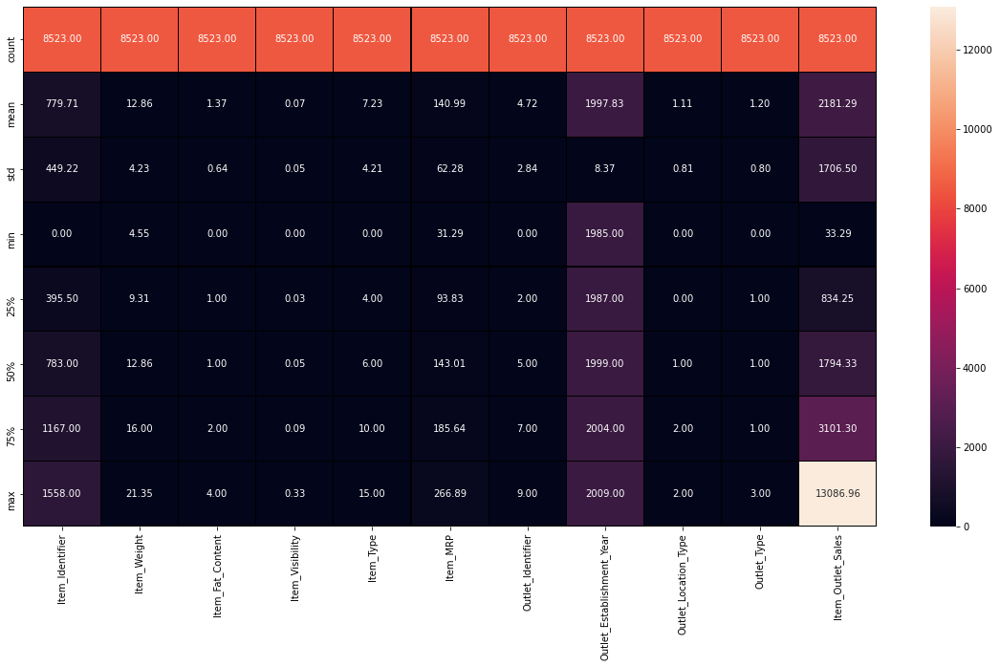

In [233]:
plt.figure(figsize=(20,10))
sns.heatmap(train_data.describe(),annot=True,linewidths=0.1,linecolor='black',fmt='0.2f')

In [234]:
train_datacor=train_data.corr()
train_datacor

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
Item_Identifier,1.000000,0.044518,-0.098114,-0.025482,-0.017973,0.012853,-0.008602,-0.012772,0.003656,-0.001178,0.002869
Item_Weight,0.044518,1.000000,-0.017331,-0.012049,0.028015,0.024756,-0.007975,-0.008301,0.004088,-0.000566,0.011550
Item_Fat_Content,-0.098114,-0.017331,1.000000,0.034042,-0.115958,-0.000876,-0.002357,-0.000189,-0.004102,-0.004214,0.009800
Item_Visibility,-0.025482,-0.012049,0.034042,1.000000,-0.035249,-0.001315,-0.100439,-0.074834,-0.028099,-0.173468,-0.128625
Item_Type,-0.017973,0.028015,-0.115958,-0.035249,1.000000,0.032651,0.001656,0.004970,0.003084,0.003053,0.017048
Item_MRP,0.012853,0.024756,-0.000876,-0.001315,0.032651,1.000000,0.003319,0.005020,0.000232,-0.001975,0.567574
Outlet_Identifier,-0.008602,-0.007975,-0.002357,-0.100439,0.001656,0.003319,1.000000,0.079035,-0.716176,0.099873,0.162325
Outlet_Establishment_Year,-0.012772,-0.008301,-0.000189,-0.074834,0.004970,0.005020,0.079035,1.000000,-0.089216,-0.122304,-0.049135
Outlet_Location_Type,0.003656,0.004088,-0.004102,-0.028099,0.003084,0.000232,-0.716176,-0.089216,1.000000,0.467219,0.089367
Outlet_Type,-0.001178,-0.000566,-0.004214,-0.173468,0.003053,-0.001975,0.099873,-0.122304,0.467219,1.000000,0.401522


<AxesSubplot:>

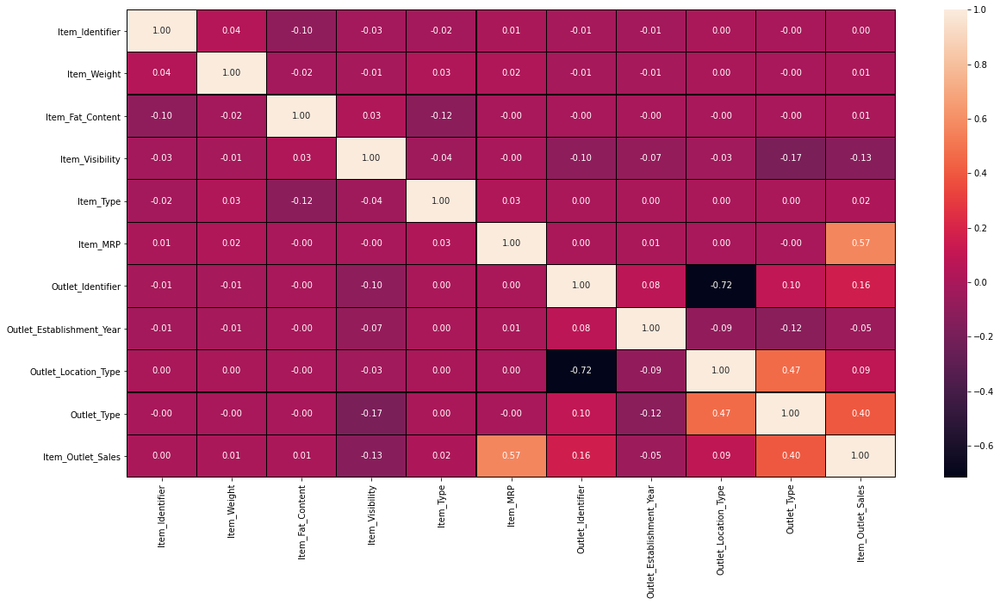

In [235]:
plt.figure(figsize=(20,10))
sns.heatmap(train_datacor,annot=True,linewidths=0.1,linecolor='black',fmt='0.2f')

In [236]:
train_data.skew()

Item_Identifier             -0.008877
Item_Weight                  0.090561
Item_Fat_Content             0.994824
Item_Visibility              1.167091
Item_Type                    0.101655
Item_MRP                     0.127202
Outlet_Identifier           -0.059861
Outlet_Establishment_Year   -0.396641
Outlet_Location_Type        -0.209093
Outlet_Type                  0.927438
Item_Outlet_Sales            1.177531
dtype: float64

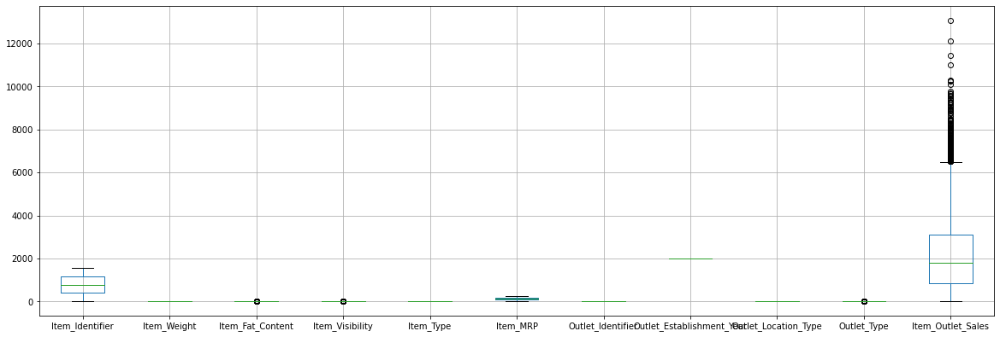

In [237]:
train_data.boxplot(figsize=[20,8])
plt.subplots_adjust(bottom=0.25)
plt.show()

In [238]:
from scipy.stats import zscore
z=np.abs(zscore(train_data))
z

array([[1.38851383, 0.84187169, 0.57284357, ..., 1.36933384, 0.25265831,
        0.910601  ],
       [1.71799137, 1.64170589, 0.97809218, ..., 1.09156913, 1.00297245,
        1.01844035],
       [0.26205684, 1.09855449, 0.57284357, ..., 1.36933384, 0.25265831,
        0.04923754],
       ...,
       [1.28515188, 0.53424315, 0.57284357, ..., 0.13888236, 0.25265831,
        0.57909963],
       [0.21975905, 1.33644372, 0.97809218, ..., 1.09156913, 1.00297245,
        0.19672492],
       [1.62449099, 0.45963367, 0.57284357, ..., 1.36933384, 0.25265831,
        0.82959407]])

In [239]:
threshold=3
print(np.where(z>3))

(array([  49,   81,   83,  108,  130,  145,  151,  174,  199,  276,  304,
        333,  339,  373,  396,  434,  456,  472,  489,  502,  521,  532,
        615,  661,  694,  727,  753,  753,  809,  838,  854,  891,  935,
        991,  997, 1009, 1010, 1034, 1090, 1124, 1133, 1138, 1159, 1183,
       1209, 1254, 1272, 1291, 1311, 1324, 1372, 1433, 1434, 1450, 1496,
       1501, 1506, 1512, 1542, 1549, 1560, 1575, 1576, 1615, 1617, 1644,
       1651, 1684, 1723, 1753, 1769, 1805, 1827, 1841, 1859, 1998, 2062,
       2088, 2109, 2111, 2122, 2143, 2168, 2173, 2216, 2223, 2238, 2251,
       2293, 2324, 2331, 2438, 2439, 2445, 2516, 2535, 2552, 2569, 2586,
       2613, 2660, 2678, 2728, 2776, 2855, 2895, 2905, 2971, 2973, 3011,
       3017, 3083, 3087, 3098, 3154, 3206, 3225, 3234, 3241, 3242, 3243,
       3286, 3335, 3367, 3399, 3407, 3458, 3474, 3480, 3488, 3491, 3497,
       3509, 3540, 3545, 3582, 3602, 3667, 3709, 3720, 3750, 3757, 3767,
       3884, 3993, 4006, 4019, 4083, 4163, 4219, 4

In [240]:
train_data_new=train_data[(z<3).all(axis=1)]

In [241]:
train_data_new

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,156,9.300000,1,0.016047,4,249.8092,9,1999,0,1,3735.1380
1,8,5.920000,2,0.019278,14,48.2692,3,2009,2,2,443.4228
2,662,17.500000,1,0.016760,10,141.6180,9,1999,0,1,2097.2700
3,1121,19.200000,2,0.000000,6,182.0950,0,1998,2,0,732.3800
4,1297,8.930000,1,0.000000,9,53.8614,1,1987,2,1,994.7052
5,758,10.395000,2,0.000000,0,51.4008,3,2009,2,2,556.6088
6,696,13.650000,2,0.012741,13,57.6588,1,1987,2,1,343.5528
7,738,12.857645,1,0.127470,13,107.7622,5,1985,2,3,4022.7636
8,440,16.200000,2,0.016687,5,96.9726,7,2002,1,1,1076.5986
9,990,19.200000,2,0.094450,5,187.8214,2,2007,1,1,4710.5350


In [242]:
train_data.shape

(8523, 11)

In [243]:
train_data_new.shape

(8222, 11)

In [244]:
Data_loss=((8523-8222)/8523*100)
Data_loss

3.5316203214830457

# Separting the Columns into Feature & Target

In [245]:
train_data.dtypes

Item_Identifier                int32
Item_Weight                  float64
Item_Fat_Content               int32
Item_Visibility              float64
Item_Type                      int32
Item_MRP                     float64
Outlet_Identifier              int32
Outlet_Establishment_Year      int64
Outlet_Location_Type           int32
Outlet_Type                    int32
Item_Outlet_Sales            float64
dtype: object

In [246]:
x=train_data.drop('Item_Outlet_Sales',axis=1)
y=train_data['Item_Outlet_Sales']

In [247]:
from sklearn.preprocessing import MinMaxScaler
mms=MinMaxScaler()
from sklearn.linear_model import LinearRegression
lr=LinearRegression()
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split

In [248]:
for i in range(0,300):
    x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.7,random_state=i)
    lr.fit(x_train,y_train)
    pred_train=lr.predict(x_train)
    pred_test=lr.predict(x_test)
    print(f'At random state {i},the training accuracy is:{r2_score(y_train,pred_train)}')
    print(f'At random state {i},the testing accuracy is:{r2_score(y_test,pred_test)}')
    print('\n')

At random state 0,the training accuracy is:0.5191982605302079
At random state 0,the testing accuracy is:0.4932785267976466


At random state 1,the training accuracy is:0.5040296600353152
At random state 1,the testing accuracy is:0.4994829899475013


At random state 2,the training accuracy is:0.5062447820729481
At random state 2,the testing accuracy is:0.49785035932031996


At random state 3,the training accuracy is:0.5142022396150161
At random state 3,the testing accuracy is:0.4932406242106824


At random state 4,the training accuracy is:0.49827061790152616
At random state 4,the testing accuracy is:0.5014926036034506


At random state 5,the training accuracy is:0.5011458981658027
At random state 5,the testing accuracy is:0.5002230471049017


At random state 6,the training accuracy is:0.49704195763309966
At random state 6,the testing accuracy is:0.5025178903165783


At random state 7,the training accuracy is:0.5266520233133869
At random state 7,the testing accuracy is:0.4884364835832162

At random state 72,the training accuracy is:0.5070250388740426
At random state 72,the testing accuracy is:0.4987074601937497


At random state 73,the training accuracy is:0.5125133023059274
At random state 73,the testing accuracy is:0.4962868537009306


At random state 74,the training accuracy is:0.5104021794519509
At random state 74,the testing accuracy is:0.4963290406243651


At random state 75,the training accuracy is:0.498848897609538
At random state 75,the testing accuracy is:0.5015782605325019


At random state 76,the training accuracy is:0.49801338826974784
At random state 76,the testing accuracy is:0.5020789635259966


At random state 77,the training accuracy is:0.5180618252562937
At random state 77,the testing accuracy is:0.49313667702123953


At random state 78,the training accuracy is:0.5031966760924196
At random state 78,the testing accuracy is:0.4990875724674154


At random state 79,the training accuracy is:0.4957495730677135
At random state 79,the testing accuracy is:0.50

At random state 142,the testing accuracy is:0.49684397505022615


At random state 143,the training accuracy is:0.5132530979608574
At random state 143,the testing accuracy is:0.49450740108056057


At random state 144,the training accuracy is:0.49015210494934036
At random state 144,the testing accuracy is:0.5033994829785473


At random state 145,the training accuracy is:0.5036444824076931
At random state 145,the testing accuracy is:0.49920626868124074


At random state 146,the training accuracy is:0.4990659313374143
At random state 146,the testing accuracy is:0.5007227733428246


At random state 147,the training accuracy is:0.5222821831170416
At random state 147,the testing accuracy is:0.4908267096401453


At random state 148,the training accuracy is:0.4927608822173327
At random state 148,the testing accuracy is:0.5052420343988999


At random state 149,the training accuracy is:0.4919245826241895
At random state 149,the testing accuracy is:0.5037308238639742


At random state 150,the trai

At random state 213,the training accuracy is:0.4964600478138008
At random state 213,the testing accuracy is:0.5017957444935656


At random state 214,the training accuracy is:0.49303737442846796
At random state 214,the testing accuracy is:0.5044385583443076


At random state 215,the training accuracy is:0.5146029867104887
At random state 215,the testing accuracy is:0.49222743090122023


At random state 216,the training accuracy is:0.5047812948791788
At random state 216,the testing accuracy is:0.4981055299711187


At random state 217,the training accuracy is:0.5077425473481638
At random state 217,the testing accuracy is:0.4978210909265778


At random state 218,the training accuracy is:0.5030240054940751
At random state 218,the testing accuracy is:0.5002253837502829


At random state 219,the training accuracy is:0.5163001331515451
At random state 219,the testing accuracy is:0.49318639265213915


At random state 220,the training accuracy is:0.48630002661188776
At random state 220,the testi

At random state 295,the training accuracy is:0.49743875011072936
At random state 295,the testing accuracy is:0.5019767329788791


At random state 296,the training accuracy is:0.4902533286479023
At random state 296,the testing accuracy is:0.5024738990597386


At random state 297,the training accuracy is:0.5031970333035115
At random state 297,the testing accuracy is:0.5004259237854918


At random state 298,the training accuracy is:0.45661914384302327
At random state 298,the testing accuracy is:0.5157949414813643


At random state 299,the training accuracy is:0.5159339316073872
At random state 299,the testing accuracy is:0.49381669438483244




In [249]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.7,random_state=0)
lr.fit(x_train,y_train)

LinearRegression()

In [250]:
predict_train=lr.predict(x_train)
print(r2_score(y_train,predict_train)*100)

51.91982605302079


In [251]:
predict_test=lr.predict(x_test)
print(r2_score(y_test,predict_test)*100)

49.32785267976466


# Cross Validation of the Model

In [252]:
Train_accuracy=r2_score(y_train,predict_train)
Test_accuracy=r2_score(y_test,predict_test)

from sklearn.model_selection import cross_val_score
for j in range(2,10):
    cv_score=cross_val_score(lr,x,y,cv=j)
    cv_mean=cv_score.mean()
    print(f'At cross fold(j) the cv score is {cv_mean} and accuracy score for training is {Train_accuracy} and accuracy score  for the {Test_accuracy}')
    print('\n')

At cross fold(j) the cv score is 0.49955758895158864 and accuracy score for training is 0.5191982605302079 and accuracy score  for the 0.4932785267976466


At cross fold(j) the cv score is 0.4999392657493928 and accuracy score for training is 0.5191982605302079 and accuracy score  for the 0.4932785267976466


At cross fold(j) the cv score is 0.4990450969742075 and accuracy score for training is 0.5191982605302079 and accuracy score  for the 0.4932785267976466


At cross fold(j) the cv score is 0.49997588091398215 and accuracy score for training is 0.5191982605302079 and accuracy score  for the 0.4932785267976466


At cross fold(j) the cv score is 0.4994530600704528 and accuracy score for training is 0.5191982605302079 and accuracy score  for the 0.4932785267976466


At cross fold(j) the cv score is 0.500439160701321 and accuracy score for training is 0.5191982605302079 and accuracy score  for the 0.4932785267976466


At cross fold(j) the cv score is 0.49976117366283335 and accuracy sco

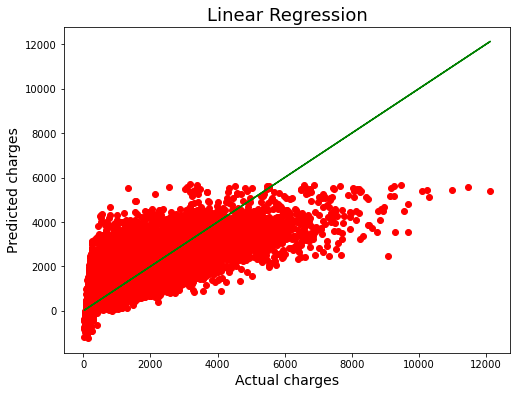

In [253]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8,6))
plt.scatter(x=y_test,y=predict_test,color='r')
plt.plot(y_test,y_test,color='g')
plt.xlabel('Actual charges',fontsize=14)
plt.ylabel('Predicted charges',fontsize=14)
plt.title('Linear Regression',fontsize=18)
plt.show()

# Regularization

In [254]:
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
import warnings
warnings.filterwarnings('ignore')

In [255]:
from sklearn.linear_model import Lasso
parameters={'alpha':[.0001,.001,0.1,.1,1,10],'random_state':list(range(0,10))}
ls=Lasso()
clf=GridSearchCV(ls,parameters)
clf.fit(x_train,y_train)
print(clf.best_params_)

{'alpha': 0.1, 'random_state': 0}


In [256]:
ls=Lasso(alpha=1,random_state=0)
ls.fit(x_train,y_train)
ls.score(x_train,y_train)
pred_ls=ls.predict(x_test)
lss=r2_score(y_test,pred_ls)
lss

0.49295154197088

# Ensemble Technique

In [257]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor
parameters={'criterion':['mse','mae'],'max_features':['auto','sqrt','log2']}
rf=RandomForestRegressor()
clf=GridSearchCV(rf,parameters)
clf.fit(x_train,y_train)
print(clf.best_params_)

{'criterion': 'mae', 'max_features': 'sqrt'}


In [258]:
rf=RandomForestRegressor(criterion='mse',max_features='auto')
rf.fit(x_train,y_train)
rf.score(x_train,y_train)
pred_decision=rf.predict(x_test)
rfs=r2_score(y_test,pred_decision)
print('R2 Score:',rfs*100)
rfscore=cross_val_score(rf,x,y,cv=5)
rfc=rfscore.mean()
print('Cross Val Score:',rfc*100)

R2 Score: 54.37559947624566
Cross Val Score: 54.73264835086829


We are getting model accuracy and cross validation score of 51% and 55% respectively.

# Reciever Operating Characteristic(ROC)

In [259]:
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score

In [260]:
#Import some data to play with
iris = datasets.load_iris()
X=iris.data
Y=iris.target

#Binarize the output
Y=label_binarize(Y,classes=[0,1,2])
n_classes=Y.shape[1]

# Add noisy feautures to make the problem harder
random_state=np.random.RandomState(42)
n_samples,n_features=X.shape
X=np.c_[X,random_state.randn(n_samples,200*n_features)]

#shuffle and so=plit training and test sets
X_train,X_test,Y_train,Y_test=train_test_split(X,Y,test_size=.7,random_state=127)

#learn to predict each class against the other
classifier=OneVsRestClassifier(svm.SVC(kernel='linear',probability=True,random_state=random_state))
Y_score=classifier.fit(X_train,Y_train).decision_function(X_test)

# Compute ROC curve and ROC area for each class 
fpr=dict()
tpr=dict()
roc_auc=dict()
for i in range(n_classes):
    fpr[i],tpr[i],_=roc_curve(Y_test[:,i],Y_score[:,i])
    roc_auc[i]=auc(fpr[i],tpr[i])
    
# Compute micro-average ROC curve and ROC area
fpr["micro"],tpr["micro"],_=roc_curve(Y_test.ravel(),Y_score.ravel())
roc_auc["micro"]=auc(fpr["micro"],tpr["micro"])

Plot of ROC curve for a specific class

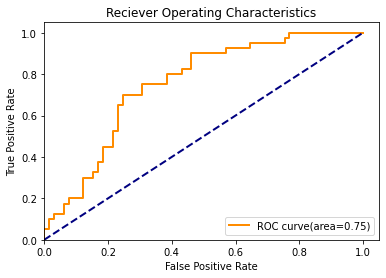

In [261]:
plt.figure()
lw=2
plt.plot(fpr[2],tpr[2],color='darkorange',
        lw=lw,label='ROC curve(area=%0.2f)'%roc_auc[2])
plt.plot([0,1],[0,1],color='navy',lw=lw,linestyle='--')
plt.xlim([0.0,1.05])
plt.ylim([0.0,1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Reciever Operating Characteristics')
plt.legend(loc="lower right")
plt.show()

In [262]:
Y_prob=classifier.predict_proba(X_test)
macro_roc_auc_ovo=roc_auc_score(Y_test,Y_prob,multi_class="ovo",average="macro")
weighted_roc_auc_ovo=roc_auc_score(Y_test,Y_prob,multi_class="ovo",average="weighted")
macro_roc_auc_ovr=roc_auc_score(Y_test,Y_prob,multi_class="ovr",average="macro")
weighted_roc_auc_ovr=roc_auc_score(Y_test,Y_prob,multi_class="ovo",average="weighted")

print("One-vs-One ROC AUC scores:\n{:.5f}(macro),\n{:.5f}"
     "(weighted by prevalance)"
     .format(macro_roc_auc_ovo, weighted_roc_auc_ovo))
print("One-vs-One ROC AUC scores:\n{:.5f}(macro),\n{:.5f}"
     "(weighted by prevalance)"
     .format(macro_roc_auc_ovr, weighted_roc_auc_ovr))

One-vs-One ROC AUC scores:
0.70824(macro),
0.70887(weighted by prevalance)
One-vs-One ROC AUC scores:
0.70824(macro),
0.70887(weighted by prevalance)


# Model Saving

In [263]:
import joblib
joblib.dump(ls,"Big_Mart_Data_Sales_Probelem.pkl")

['Big_Mart_Data_Sales_Probelem.pkl']